In [1]:
# Importing the libraries 

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Ignore harmless warnings

import warnings
warnings.filterwarnings("ignore")


# Set to display all the columns in dataset

pd.set_option("display.max_columns", None)


# Import psql to run queries

import pandasql as psql

In [2]:
# load the dataset 

CreditCard = pd.read_csv(r"C:\Users\Greesma\OneDrive\NASSCOM-AIML\creditcard.csv", header=0)


# Copy to back-up file

CreditCard_BK = CreditCard.copy()


# Display the first 5 records

CreditCard.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [3]:
# Display the dataset information

CreditCard.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

In [4]:
# Displaying Duplicate values with in dataset

CreditCard_dup = CreditCard[CreditCard.duplicated(keep='last')]


# Display the duplicate records

CreditCard_dup

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
32,26.0,-0.529912,0.873892,1.347247,0.145457,0.414209,0.100223,0.711206,0.176066,-0.286717,-0.484688,0.872490,0.851636,-0.571745,0.100974,-1.519772,-0.284376,-0.310524,-0.404248,-0.823374,-0.290348,0.046949,0.208105,-0.185548,0.001031,0.098816,-0.552904,-0.073288,0.023307,6.14,0
34,26.0,-0.535388,0.865268,1.351076,0.147575,0.433680,0.086983,0.693039,0.179742,-0.285642,-0.482474,0.871800,0.853447,-0.571822,0.102252,-1.519991,-0.285912,-0.309633,-0.403902,-0.823743,-0.283264,0.049526,0.206537,-0.187108,0.000753,0.098117,-0.553471,-0.078306,0.025427,1.77,0
112,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
113,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
114,74.0,1.038370,0.127486,0.184456,1.109950,0.441699,0.945283,-0.036715,0.350995,0.118950,-0.243289,0.578063,0.674730,-0.534231,0.446601,1.122885,-1.768001,1.241157,-2.449500,-1.747255,-0.335520,0.102520,0.605089,0.023092,-0.626463,0.479120,-0.166937,0.081247,0.001192,1.18,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
282986,171288.0,1.912550,-0.455240,-1.750654,0.454324,2.089130,4.160019,-0.881302,1.081750,1.022928,0.005356,-0.541998,0.745036,-0.375165,-0.068227,-0.795939,-0.497901,-0.134224,-1.004958,0.086074,-0.207620,-0.524067,-1.337510,0.473943,0.616683,-0.283548,-1.084843,0.073133,-0.036020,11.99,0
283482,171627.0,-1.464380,1.368119,0.815992,-0.601282,-0.689115,-0.487154,-0.303778,0.884953,0.054065,-0.828015,-1.192581,0.944989,1.372532,-0.036493,-0.208747,0.320086,-0.204910,-0.024821,-0.468859,0.031950,0.287217,0.947825,-0.218773,0.082926,0.044127,0.639270,0.213565,0.119251,6.82,0
283484,171627.0,-1.457978,1.378203,0.811515,-0.603760,-0.711883,-0.471672,-0.282535,0.880654,0.052808,-0.830603,-1.191774,0.942870,1.372621,-0.037988,-0.208490,0.321883,-0.205951,-0.025225,-0.468427,0.023667,0.284205,0.949659,-0.216949,0.083250,0.044944,0.639933,0.219432,0.116772,11.93,0
284190,172233.0,-2.667936,3.160505,-3.355984,1.007845,-0.377397,-0.109730,-0.667233,2.309700,-1.639306,-1.449823,-0.508930,0.600035,-0.627313,1.017499,-0.887384,0.420096,1.856497,1.315099,1.096112,-0.821707,0.391483,0.266536,-0.079853,-0.096395,0.086719,-0.451128,-1.183743,-0.222200,55.66,0


In [5]:
# Remove the identified duplicate records 

CreditCard = CreditCard.drop_duplicates()


# Display the shape of the dataset

CreditCard.shape

(283726, 31)

In [6]:
# Re-setting the row index

CreditCard = CreditCard.reset_index(drop=True)


# Copy file to back-up file after deletion of duplicate records

CreditCard_BK2 = CreditCard.copy()

In [7]:
# Display the dataset information after delection of duplicates

CreditCard.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 283726 entries, 0 to 283725
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    283726 non-null  float64
 1   V1      283726 non-null  float64
 2   V2      283726 non-null  float64
 3   V3      283726 non-null  float64
 4   V4      283726 non-null  float64
 5   V5      283726 non-null  float64
 6   V6      283726 non-null  float64
 7   V7      283726 non-null  float64
 8   V8      283726 non-null  float64
 9   V9      283726 non-null  float64
 10  V10     283726 non-null  float64
 11  V11     283726 non-null  float64
 12  V12     283726 non-null  float64
 13  V13     283726 non-null  float64
 14  V14     283726 non-null  float64
 15  V15     283726 non-null  float64
 16  V16     283726 non-null  float64
 17  V17     283726 non-null  float64
 18  V18     283726 non-null  float64
 19  V19     283726 non-null  float64
 20  V20     283726 non-null  float64
 21  V21     28

In [8]:
# Display the unique values of the all the variables

CreditCard.nunique()

Time      124592
V1        275663
V2        275663
V3        275663
V4        275663
V5        275663
V6        275663
V7        275663
V8        275663
V9        275663
V10       275663
V11       275663
V12       275663
V13       275663
V14       275663
V15       275663
V16       275663
V17       275663
V18       275663
V19       275663
V20       275663
V21       275663
V22       275663
V23       275663
V24       275663
V25       275663
V26       275663
V27       275663
V28       275663
Amount     32767
Class          2
dtype: int64

In [9]:
# Display the missing values information of variables

CreditCard.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [10]:
# Display all the variables

CreditCard.columns

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class'],
      dtype='object')

In [11]:
# Identify the variables for scaling (MinMaxScalar)

cols = ['Time','V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28','Amount']

In [12]:
# Identify the independent and Target (dependent) variables

IndepVar = []
for col in CreditCard.columns:
    if col != 'Class':
        IndepVar.append(col)

TargetVar = 'Class'

x = CreditCard[IndepVar]
y = CreditCard[TargetVar]

In [13]:
# Split the data into train and test (random sampling)

from sklearn.model_selection import train_test_split 

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

# Display the shape for train & test data

x_train.shape, x_test.shape, y_train.shape, y_test.shape

((198608, 30), (85118, 30), (198608,), (85118,))

In [14]:
# Scaling the features by using MinMaxScaler

from sklearn.preprocessing import MinMaxScaler

mmscaler = MinMaxScaler(feature_range=(0, 1))

x_train[cols] = mmscaler.fit_transform(x_train[cols])
x_train = pd.DataFrame(x_train)

x_test[cols] = mmscaler.fit_transform(x_test[cols])
x_test = pd.DataFrame(x_test)

# Regression Algorithm with CreditCard dataset

In [15]:
# Train the algorithm and build the model with train dataset
from sklearn.linear_model import LinearRegression

# Create an object for regression model
ModelRGR = LinearRegression()

# Train the model with training dataset
ModelRGR.fit(x_train, y_train)

# Predict the model with test dataset
y_pred = ModelRGR.predict(x_test)

# Evaluation metrics for Regression model
from sklearn import metrics
print('Mean Absolute Error (MAE):', round(metrics.mean_absolute_error(y_test, y_pred),3))  
print('Mean Squared Error (MSE):', round(metrics.mean_squared_error(y_test, y_pred),3))  
print('Root Mean Squared Error (RMSE):', round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),3))
print('R2_score:', round(metrics.r2_score(y_test, y_pred),6)) 
print('Mean Absolute Percentage Error (MAPE):', round(metrics.mean_absolute_percentage_error(y_test, y_pred)*100,3), '%')
print('Root Mean Squared Log Error (RMSLE):', round(np.log(np.sqrt(metrics.mean_squared_error(y_test, y_pred))),3))

# Define the function to calculate the MAPE - Mean Absolute Percentage Error
def MAPE (y_test, y_pred): 
    y_test, y_pred = np.array(y_test), np.array(y_pred)
    return np.mean(np.abs((y_test - y_pred) / y_test)) * 100

# Evaluation of MAPE 
result = MAPE(y_test, y_pred)
print('Mean Absolute Percentage Error (MAPE):', round(result, 3), '%')

# Calculate Adjusted R squared values 
r_squared = round(metrics.r2_score(y_test, y_pred),6)
adjusted_r_squared = round(1 - (1-r_squared)*(len(y)-1)/(len(y)-x.shape[1]-1),6)
print('Adj R Square: ', adjusted_r_squared)


Mean Absolute Error (MAE): 0.527
Mean Squared Error (MSE): 0.278
Root Mean Squared Error (RMSE): 0.527
R2_score: -175.932278
Mean Absolute Percentage Error (MAPE): 2.3650388462023024e+17 %
Root Mean Squared Log Error (RMSLE): -0.64
Mean Absolute Percentage Error (MAPE): inf %
Adj R Square:  -175.950988


In [16]:
# Display the Final results 

Results = pd.DataFrame({'Class_A':y_test, 'Class_P':y_pred})

# Merge two Dataframes on index of both the dataframes

ResultsFinal = CreditCard_BK2.merge(Results, left_index=True, right_index=True)

# Display 10 records randomly

ResultsFinal.sample(10)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class,Class_A,Class_P
123792,77236.0,-0.427949,0.806970,1.348380,0.714499,0.422840,0.159996,0.778832,0.090203,-0.263043,-0.589154,-1.047463,0.004540,-0.295572,-0.025016,-0.263614,-0.713453,0.161044,-0.659016,-0.072068,-0.071323,-0.031755,0.052895,-0.196061,-0.291357,0.252189,-0.331358,0.081291,0.054202,30.63,0,0,-0.534304
100867,67770.0,1.388577,-1.326612,0.800553,-1.253255,-2.000252,-0.744903,-1.286566,-0.100057,-1.444971,1.413673,-0.657283,-1.235668,-0.007427,-0.415265,0.900519,-0.104720,0.406375,0.474115,-0.485141,-0.246053,0.021200,0.340441,-0.072919,0.380290,0.330761,-0.050743,0.041461,0.035704,67.00,0,0,-0.506170
67464,52673.0,1.260134,0.214034,0.266012,0.753898,-0.462313,-1.205416,0.249582,-0.291368,0.133535,-0.115323,-0.247115,0.458986,-0.066624,0.196374,0.022143,-0.428519,0.102327,-0.750018,0.005805,-0.137037,-0.046737,0.030654,-0.067609,0.775756,0.623569,0.534601,-0.051205,0.003987,0.00,0,0,-0.525825
112462,72851.0,-0.720704,0.787134,0.395774,0.833174,0.254979,0.117276,0.155820,0.551537,-0.123370,-0.342123,-2.209723,-0.615416,-0.531870,0.424384,0.524796,0.075396,-0.249325,0.388967,1.171536,0.171727,-0.174760,-0.596089,-0.064393,-1.054398,0.098038,-0.379073,0.200415,0.002751,48.98,0,0,-0.529279
183310,126039.0,1.946804,-1.644966,0.827662,0.168627,-2.254832,0.489110,-1.989309,0.359752,1.657079,0.473884,-2.174997,0.069361,-0.520996,-1.333932,-1.564233,-1.600413,0.388454,1.357124,-0.509006,-0.607529,-0.286457,0.115754,0.234055,0.007184,-0.531936,0.742319,0.057465,-0.028444,40.00,0,0,-0.496453
35784,38322.0,0.898248,-1.045212,0.757245,0.564291,-1.181862,0.436998,-0.717059,0.216628,-0.694335,0.752419,0.960489,0.691683,0.000015,0.037173,-0.096432,-1.515966,-0.018794,1.524795,-1.232765,-0.249189,-0.068155,0.070414,-0.175504,0.000005,0.356257,-0.226290,0.059005,0.048190,170.00,0,0,-0.512231
277980,168599.0,-2.137987,-1.834806,0.629473,-2.432393,2.610355,-2.186331,-0.620366,-0.300761,-0.968568,0.670046,0.422266,-0.506317,-0.224288,-0.174038,-1.185039,1.568109,-0.858037,-0.693685,-0.257984,-0.214550,0.302603,1.162884,-0.911936,-0.387127,0.525021,-0.092803,0.286271,-0.194069,15.00,0,0,-0.525027
98414,66818.0,-4.074675,3.465175,-0.580314,-2.247628,-0.954997,-0.417250,-0.198523,0.895799,2.636254,3.870344,1.244647,0.612010,-0.637591,-0.483352,0.338669,0.479376,-0.709342,-0.339419,-1.166368,1.810994,-0.448143,-0.485835,0.196171,-0.348938,0.459978,0.826821,1.626088,0.896304,3.84,0,0,-0.524430
88905,62482.0,1.090766,-0.102257,0.119511,0.233132,-0.599877,-1.472244,0.446146,-0.356625,-0.085304,-0.178114,0.125502,0.324040,-0.123656,0.487663,0.851397,0.039787,-0.074529,-1.083405,0.126880,0.105089,-0.365221,-1.332133,0.165586,0.734198,0.017809,0.591869,-0.119586,0.023693,103.93,0,0,-0.529630
228081,145721.0,-0.796219,0.899014,1.541281,-1.102172,0.058134,-0.481829,0.764504,-0.600623,1.251010,0.241671,-0.607392,0.142256,0.239562,-0.906236,0.415306,-0.085576,-0.798197,-0.382319,-0.227335,0.072721,-0.195740,-0.345134,-0.088758,-0.041060,-0.302403,-0.388267,-0.881154,-0.357485,4.62,0,0,-0.539611


In [17]:
# Calculate the %of Error

ResultsFinal['%Error'] = round(((ResultsFinal['Class_A']-ResultsFinal['Class_P'])/ResultsFinal['Class_A'])*100,3)

In [18]:
del ResultsFinal['Class_A']

ResultsFinal.sample(10)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class,Class_P,%Error
3915,3566.0,-1.707243,1.349532,-0.023764,0.976493,0.478777,0.929128,-0.278697,1.085614,-0.673521,0.025636,-0.201413,1.353855,1.280138,0.442421,-0.527527,-0.441001,0.141200,0.161352,1.488300,0.094292,-0.012699,0.141972,-0.387899,-1.284844,0.150949,-0.165290,0.224770,0.041741,24.65,0,-0.526170,inf
258505,159126.0,1.708914,-0.435478,-2.807580,0.520198,0.916631,0.033719,0.280224,0.022416,0.825474,-0.913163,0.193991,-0.185274,-1.316788,-1.570187,-0.572824,0.578752,1.040792,1.369950,0.510521,0.159476,-0.095426,-0.500163,-0.178733,-0.602132,0.195157,-0.290205,-0.032340,0.004782,186.03,0,-0.516266,inf
117584,74931.0,-0.773852,-3.894198,0.394046,1.307104,-2.575488,0.765632,-0.092644,0.182595,-0.574880,0.505125,1.131564,-0.061532,-0.956820,0.445858,1.218906,-0.651226,-0.307479,2.309785,-2.060862,1.410146,0.574164,-0.178441,-0.810718,0.210297,-0.298393,-0.339778,-0.085658,0.208822,1013.88,0,-0.514606,inf
220602,142553.0,1.727865,-1.252653,-0.343915,0.505242,-1.116273,0.299299,-1.016057,0.268793,-0.242982,1.167625,0.468709,-0.231862,-1.236110,0.455084,0.569834,-0.531096,-0.775668,2.226614,-1.334069,-0.414444,-0.235801,-0.634721,0.332566,0.555798,-0.646478,-0.909476,0.043022,0.002763,156.35,0,-0.512230,inf
242626,151967.0,1.946935,-0.369660,-0.790627,1.344894,-0.000914,0.494624,-0.424111,0.234419,1.501414,0.023663,-2.232775,-0.541949,-1.987935,0.067789,-0.860419,-0.159359,-0.162159,-0.468052,0.424819,-0.331662,-0.581286,-1.539022,0.399865,-0.112964,-0.293017,-1.088151,0.035880,-0.031636,26.80,0,-0.524191,inf
145562,87460.0,1.163970,-1.457407,-1.189618,1.514680,-0.551672,-0.030003,0.224366,-0.018427,0.603610,0.216258,0.293519,0.333136,-1.123901,0.640181,-0.244366,0.403197,-0.782485,0.641236,-0.246387,0.501555,0.312321,0.071453,-0.226951,-0.432412,-0.191813,-0.689671,-0.050067,0.016452,413.14,0,-0.526826,inf
61522,49980.0,1.213469,-1.344447,0.870134,-2.190577,-1.873063,-0.363663,-1.287496,0.124531,0.615419,-0.130915,0.935366,0.684743,0.171897,-0.040331,1.504385,-1.088733,-0.534884,2.586128,-0.050136,-0.308125,-0.049551,0.265373,-0.116338,0.028182,0.209494,0.115774,0.058944,0.034591,80.00,0,-0.506223,inf
159138,112884.0,1.313422,-3.051341,-0.756079,-1.075333,-2.291253,-0.458293,-0.883188,-0.191928,-0.856509,1.289314,-1.049626,-0.875486,0.248771,-0.493879,0.270362,-0.142535,0.415412,0.050124,-0.411726,0.526701,-0.031826,-0.704826,0.007555,-0.128790,-0.791788,-0.456292,-0.044912,0.049213,499.00,0,-0.507134,inf
69996,53788.0,-0.516598,-0.202992,0.901806,-2.417599,-1.245576,-0.529604,-0.797597,0.601161,-2.446430,0.991188,1.134268,-0.420171,-0.310245,0.174085,-0.565121,-0.207330,0.515059,0.118570,-1.080495,-0.407094,-0.031730,0.169771,0.114365,0.161163,-0.338924,-0.403320,0.193454,0.015925,15.00,0,-0.512791,inf
237816,149782.0,-1.903104,-0.426047,0.718512,-1.298371,2.388512,-1.559493,0.167787,-0.028412,-0.211590,-0.462487,0.300756,0.888164,0.201511,0.162399,-1.608136,0.627810,-1.225986,-0.285801,-0.578259,-0.326291,-0.321961,-0.762272,-0.459455,-0.452880,0.076166,0.054707,0.326334,0.066518,3.59,0,-0.532936,inf


# Logistic Regression with CreditCard dataset

In [19]:
# To build the 'Logistic Regression' model with random sampling

from sklearn.linear_model import LogisticRegression

# Create an object for model

ModelLR = LogisticRegression()
#ModelLR = LogisticRegression(penalty='l2', dual=False, tol=0.0001, C=1.0, fit_intercept=True, intercept_scaling=1, 
#                             class_weight=None, random_state=None, solver='lbfgs', max_iter=100, multi_class='auto', 
#                             verbose=0, warm_start=False, n_jobs=None, l1_ratio=None)

# Train the model train data 

ModelLR.fit(x_train, y_train)

# Predict the model with test data

y_pred = ModelLR.predict(x_test)
y_pred_prob = ModelLR.predict_proba(x_test)

In [26]:
# 'Confusion matrix' and 'classification report' in sklearn

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

# Actual values

actual = y_test

# Predicted values

predicted = y_pred

# Confusion matrix

matrix = confusion_matrix(actual,predicted, labels=[1,0], sample_weight=None, normalize=None)
print('Confusion matrix : \n', matrix)

# Outcome values order in sklearn

tp, fn, fp, tn = confusion_matrix(actual,predicted,labels=[1,0]).reshape(-1)
print('Outcome values : \n', tp, fn, fp, tn)

# Classification report for precision, recall f1-score and accuracy

C_Report = classification_report(actual,predicted,labels=[1,0])

print('Classification report : \n', C_Report)

# Calculating the metrics

sensitivity = round(tp/(tp+fn), 3);
specificity = round(tn/(tn+fp), 3);
accuracy = round((tp+tn)/(tp+fp+tn+fn), 3);
balanced_accuracy = round((sensitivity+specificity)/2, 3);
    
precision = round(tp/(tp+fp), 3);
f1Score = round((2*tp/(2*tp + fp + fn)), 3);

# Matthews Correlation Coefficient (MCC). Range of values of MCC lie between -1 to +1. 
# A model with a score of +1 is a perfect model and -1 is a poor model

from math import sqrt

mx = (tp+fp) * (tp+fn) * (tn+fp) * (tn+fn)
MCC = round(((tp * tn) - (fp * fn)) / sqrt(mx), 3)

print('Accuracy :', round(accuracy*100, 2),'%')
print('Precision :', round(precision*100, 2),'%')
print('Recall :', round(sensitivity*100,2), '%')
print('F1 Score :', f1Score)
print('Specificity or True Negative Rate :', round(specificity*100,2), '%')
print('Balanced Accuracy :', round(balanced_accuracy*100, 2),'%')
print('MCC :', MCC)

# Area under ROC curve 

from sklearn.metrics import roc_curve, roc_auc_score

print('roc_auc_score:', round(roc_auc_score(actual, predicted), 3))

# ROC Curve

from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
model_roc_auc = roc_auc_score(actual, predicted)
fpr, tpr, thresholds = roc_curve(actual, ModelLR.predict_proba(x_test)[:,1])
plt.figure()

Confusion matrix : 
 [[   44    90]
 [    8 84976]]
Outcome values : 
 44 90 8 84976
Classification report : 
               precision    recall  f1-score   support

           1       0.85      0.33      0.47       134
           0       1.00      1.00      1.00     84984

    accuracy                           1.00     85118
   macro avg       0.92      0.66      0.74     85118
weighted avg       1.00      1.00      1.00     85118

Accuracy : 99.9 %
Precision : 84.6 %
Recall : 32.8 %
F1 Score : 0.473
Specificity or True Negative Rate : 100.0 %
Balanced Accuracy : 66.4 %
MCC : 0.527
roc_auc_score: 0.664


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

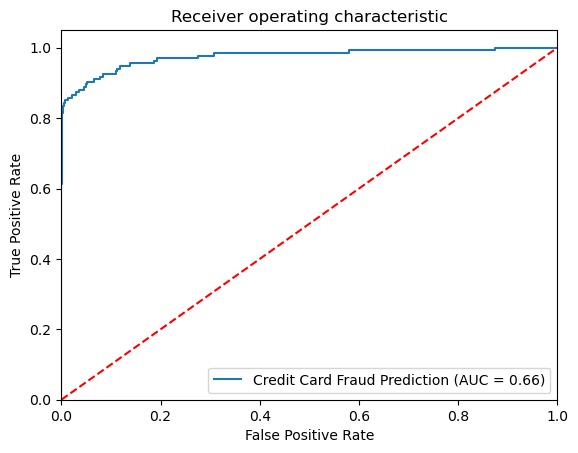

-----------------------------------------------------------------------------------------------------


In [27]:
plt.plot(fpr, tpr, label='Credit Card Fraud Prediction (AUC = {:.2f})'.format(model_roc_auc))
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic')
plt.legend(loc="lower right")
plt.show() 
print('-----------------------------------------------------------------------------------------------------')

# Decision Tree Classifier

Model Name: LogisticRegression()
Confusion matrix:
 [[   35    99]
 [    8 84976]]
Outcome values:
 35 99 8 84976
Classification report:
               precision    recall  f1-score   support

           1       0.81      0.26      0.40       134
           0       1.00      1.00      1.00     84984

    accuracy                           1.00     85118
   macro avg       0.91      0.63      0.70     85118
weighted avg       1.00      1.00      1.00     85118

Accuracy: 99.9 %
Precision: 81.4 %
Recall: 26.1 %
F1 Score: 0.395
Specificity or True Negative Rate: 100.0 %
Balanced Accuracy: 63.1 %
MCC: 0.461
roc_auc_score: 0.975


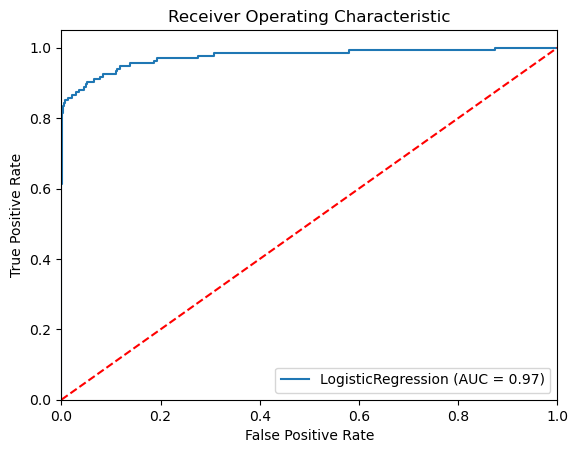

Model Name: DecisionTreeClassifier()
Confusion matrix:
 [[   17   117]
 [ 1048 83936]]
Outcome values:
 17 117 1048 83936
Classification report:
               precision    recall  f1-score   support

           1       0.02      0.13      0.03       134
           0       1.00      0.99      0.99     84984

    accuracy                           0.99     85118
   macro avg       0.51      0.56      0.51     85118
weighted avg       1.00      0.99      0.99     85118

Accuracy: 98.6 %
Precision: 1.6 %
Recall: 12.7 %
F1 Score: 0.028
Specificity or True Negative Rate: 98.8 %
Balanced Accuracy: 55.8 %
MCC: 0.041
roc_auc_score: 0.557


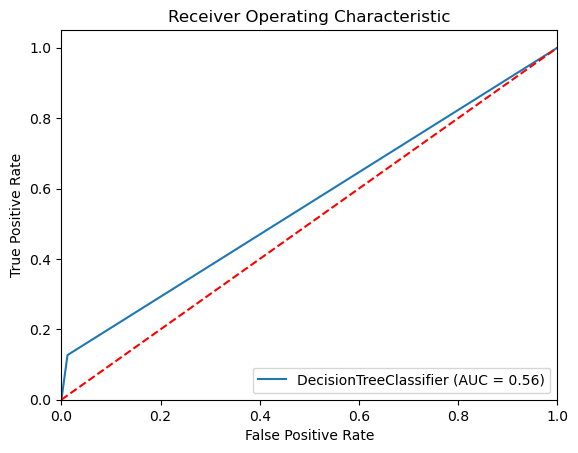

Model Name: RandomForestClassifier()
Confusion matrix:
 [[   56    78]
 [    8 84976]]
Outcome values:
 56 78 8 84976
Classification report:
               precision    recall  f1-score   support

           1       0.88      0.42      0.57       134
           0       1.00      1.00      1.00     84984

    accuracy                           1.00     85118
   macro avg       0.94      0.71      0.78     85118
weighted avg       1.00      1.00      1.00     85118

Accuracy: 99.9 %
Precision: 87.5 %
Recall: 41.8 %
F1 Score: 0.566
Specificity or True Negative Rate: 100.0 %
Balanced Accuracy: 70.9 %
MCC: 0.604
roc_auc_score: 0.946


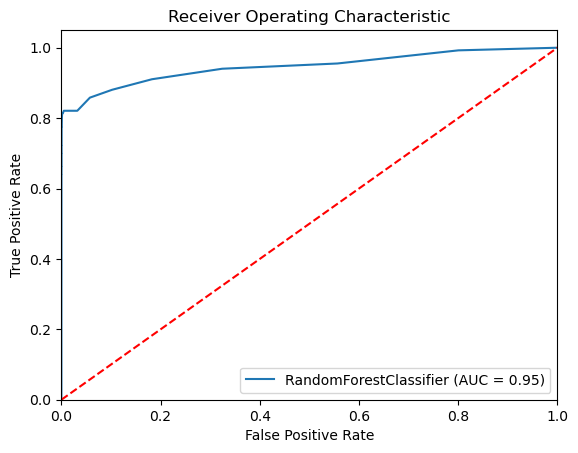

Model Name: ExtraTreesClassifier()
Confusion matrix:
 [[   50    84]
 [    8 84976]]
Outcome values:
 50 84 8 84976
Classification report:
               precision    recall  f1-score   support

           1       0.86      0.37      0.52       134
           0       1.00      1.00      1.00     84984

    accuracy                           1.00     85118
   macro avg       0.93      0.69      0.76     85118
weighted avg       1.00      1.00      1.00     85118

Accuracy: 99.9 %
Precision: 86.2 %
Recall: 37.3 %
F1 Score: 0.521
Specificity or True Negative Rate: 100.0 %
Balanced Accuracy: 68.6 %
MCC: 0.567
roc_auc_score: 0.935


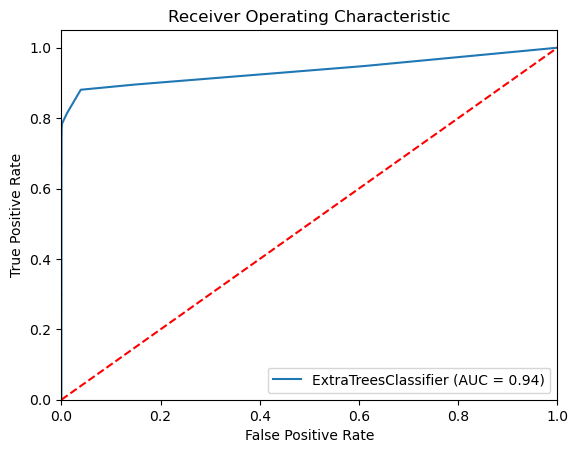

AttributeError: 'Flags' object has no attribute 'c_contiguous'

In [29]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from math import sqrt

# Create objects of classification algorithm with default hyperparameters
ModelLR = LogisticRegression()
ModelDC = DecisionTreeClassifier()
ModelRF = RandomForestClassifier()
ModelET = ExtraTreesClassifier()
ModelKNN = KNeighborsClassifier(n_neighbors=5)
ModelSVM = SVC(probability=True)

# Evaluation matrix for all the algorithms
MM = [ModelLR, ModelDC, ModelRF, ModelET, ModelKNN, ModelSVM]

for model in MM:
    # Fit the model to the training data
    model.fit(x_train, y_train)
    
    # Predict the model with test data 
    y_pred = model.predict(x_test)
    y_pred_prob = model.predict_proba(x_test)[:, 1]
    
    # Print the model name
    print('Model Name:', model)
    
    # Confusion matrix in sklearn
    matrix = confusion_matrix(y_test, y_pred, labels=[1, 0], sample_weight=None, normalize=None)
    print('Confusion matrix:\n', matrix)

    # Outcome values order in sklearn
    tp, fn, fp, tn = matrix.reshape(-1)
    print('Outcome values:\n', tp, fn, fp, tn)

    # Classification report for precision, recall, f1-score, and accuracy
    C_Report = classification_report(y_test, y_pred, labels=[1, 0])
    print('Classification report:\n', C_Report)

    # Calculating the metrics
    sensitivity = round(tp / (tp + fn), 3)
    specificity = round(tn / (tn + fp), 3)
    accuracy = round((tp + tn) / (tp + fp + tn + fn), 3)
    balanced_accuracy = round((sensitivity + specificity) / 2, 3)
    
    precision = round(tp / (tp + fp), 3)
    f1Score = round((2 * tp / (2 * tp + fp + fn)), 3)

    # Matthews Correlation Coefficient (MCC)
    mx = (tp + fp) * (tp + fn) * (tn + fp) * (tn + fn)
    MCC = round(((tp * tn) - (fp * fn)) / sqrt(mx), 3)

    print('Accuracy:', round(accuracy * 100, 2), '%')
    print('Precision:', round(precision * 100, 2), '%')
    print('Recall:', round(sensitivity * 100, 2), '%')
    print('F1 Score:', f1Score)
    print('Specificity or True Negative Rate:', round(specificity * 100, 2), '%')
    print('Balanced Accuracy:', round(balanced_accuracy * 100, 2), '%')
    print('MCC:', MCC)

    # Area under ROC curve 
    auc_score = round(roc_auc_score(y_test, y_pred_prob), 3)
    print('roc_auc_score:', auc_score)
    
    # ROC Curve
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    plt.figure()
    plt.plot(fpr, tpr, label='{} (AUC = {:.2f})'.format(str(model).split('(')[0], auc_score))
    plt.plot([0, 1], [0, 1], 'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()

# Random Forest Classification

In [30]:
sns.pairplot(CreditCard)